# Clean viz 

Producing a clean visualization to present 

-------------------

#### Bus stop example

In [2]:
# import sys
# !{sys.executable} -m pip install folium matplotlib mapclassify

In [2]:
import geopandas as gpd
import pandas as pd
import polars as pl

In [4]:
def merge_areas_by_time(gdf_stops_reach_areas: gpd.GeoDataFrame) -> gpd.GeoDataFrame: 
    """
    Takes all the reachable areas for stop-pid-time combination and merges
    the shape by stop-time. 
    """

    # Standardize column names and clean time labels
    gdf_stop_areas = gdf_stops_reach_areas.rename(columns={"stpid": "stop_id"})

    # TODO: Apply dissolved grouped by stop_id and time budget
    gdf_dissolved = gdf_stop_areas.dissolve(by = "time_budget").reset_index()
    gdf_dissolved = gdf_stop_areas

    # logging.info(f"{gdf_dissolved = }")

    gdf_dissolved["minutes"] = gdf_dissolved["time_budget"].transform(
        lambda x: x.seconds / 60
    )

    # TODO: Pasar implementación a vectores con los valores del tiempo 
    gdf_dissolved["time_label"] = gdf_dissolved["minutes"].case_when(
        [
            (gdf_dissolved.eval(f"minutes == {str(2)}"), "2 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(5)}"), "5 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(10)}"), "10 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(15)}"), "15 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(30)}"), "30 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(60)}"), "1 hour"),
            (gdf_dissolved.eval(f"minutes == {str(90)}"), "1 hour 30 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(120)}"), "2 hours")
        ]
    )


    # gdf_dissolved["time_label"] = pd.Categorical(gdf_dissolved["time_label"], 
    #                                               categories = ["2 minutes", 
    #                                                             "5 minutes",
    #                                                             "10 minutes", 
    #                                                             "15 minutes"])

    
    gdf_dissolved["time_label"] = pd.Categorical(gdf_dissolved["time_label"], 
                                                  categories = [ 
                                                                "5 minutes", 
                                                                "10 minutes", 
                                                                "15 minutes",
                                                                "30 minutes",
                                                                "1 hour",
                                                                "1 hour 30 minutes",
                                                                "2 hours"])

    return gdf_dissolved

In [13]:
gdf73 = gpd.read_parquet("out/stops_parquets/73_copy.parquet")
gdf73 = merge_areas_by_time(gdf73)
gdf73.head(3)
gdf73 = gdf73.drop(columns = ["time_budget"])
gdf73 = gdf73.sort_values("minutes")
gdf73 = gdf73.iloc[::-1] # Decreasing order

<Axes: >

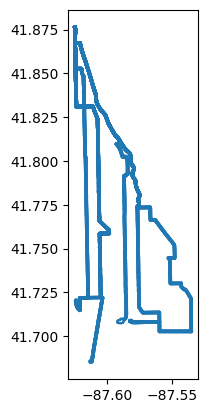

In [6]:
gdf73.boundary.plot()

In [15]:
gdf73.explore(column = "time_label",
              # cmap = "RdYlGn_r",
            # cmap = "Greens_r",
            # cmap = "YlGn_r",
            cmap = "summer",
              opacity = 0.1,
              tiles="CartoDB positron")

-----------------
# Community level map 
Bridgeport

In [10]:
gdf_community = gpd.read_parquet("out/stops_parquets/BRIDGEPORT_stops_discrete.parquet")
# gdf_community = gdf_community.drop(columns = ["time_budget"])
# gdf_community = gdf_community.sort_values("minutes")
gdf_community = gdf_community.iloc[::-1] # Decreasing order
gdf_community.head(3)

,geometry,segments,length_ft,ls_geometry,pid,origin_stop,time_budget,minutes,time_label
0,"POLYGON ((-87.80003 41.79164, -87.80004 41.791...",0,0.0,POINT (-87.64444 41.84828),7124,4468,0 days 02:00:00,120,2 hours
0,"POLYGON ((-87.80003 41.79164, -87.80004 41.791...",0,0.0,POINT (-87.64444 41.84828),7124,4468,0 days 01:30:00,90,1 hour 30 minutes
0,"POLYGON ((-87.80003 41.79164, -87.80004 41.791...",0,0.0,POINT (-87.64444 41.84828),7124,4468,0 days 01:00:00,60,1 hour


In [12]:
gdf_community["time_budget"] = gdf_community["time_budget"].astype(str)
# gdf_community.explore(column = "time_label", 
#               cmap = "RdYlGn_r", 
#               tiles="CartoDB positron")

gdf_community.explore(column = "minutes", 
              cmap = "summer", 
              tiles="CartoDB positron")

KeyboardInterrupt: 

In [ ]:
# Date formatting 
from datetime import datetime, timedelta
td = timedelta(days=2, hours=3, minutes=5, seconds=8, microseconds=340)
td

hours, remainder = divmod(td.total_seconds(), 3600)
minutes, seconds = divmod(remainder, 60)

td = datetime.now()

# This is the needed f string formatting 
print(f"{td:%M minutes}")
print(f"{td:%H hour %M minutes}")


04 minutes
14 hour 04 minutes


In [ ]:
# 
gdf_community["time_label"] = gdf_community["minutes"].case_when(
    [(gdf_community.eval("minutes < 60"), "Less than an hour"),
    (gdf_community.eval("minutes >= 60"), "More than an hour")]    
)

gdf_community["minutes"][gdf_community["minutes"] < 60] = 


-----------------
# Continuous map

In [3]:
gdf73 = gpd.read_parquet("out/stops_parquets/73_continuous.parquet")

print(gdf73.columns)

# gdf73["time_to_previous"] = gdf73["time_to_previous"].astype(str)
# gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].astype(str)

gdf73["time_to_previous"] = gdf73["time_to_previous"].dt.total_seconds() / 60
gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].dt.total_seconds() / 60


gdf73["travel_time_elapsed"]

Index(['rt', 'pid', 'stop_sequence', 'stop_id', 'period_value',
       'time_to_previous', 'travel_time_elapsed', 'route', 'lat', 'lon', 'typ',
       'stpnm', 'pdist', 'geometry', 'segment', 'p_stp_id', 'segment_geom'],
      dtype='object')


0       0.000000
1       0.934546
2       1.448704
3       2.385189
4       3.294868
         ...    
105    73.430241
0       0.000000
1       2.019463
0       0.000000
1       1.665204
Name: travel_time_elapsed, Length: 640, dtype: float64

In [ ]:
gdf73.explore(column = "travel_time_elapsed",
              # cmap = "RdYlGn",
            cmap = "Greens_r",
            # cmap = "YlGn_r",
            # cmap = "summer",
              opacity = 1,
              tiles="CartoDB positron")

In [ ]:
gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].astype(str)


gdf73.explore(column = "travel_time_elapsed",
              cmap = "RdYlGn",
            # cmap = "Greens_r",
            # cmap = "YlGn_r",
            # cmap = "summer",
              opacity = 1,
              tiles="CartoDB positron")

In [8]:
# Community level continuous map
gdf_community_c = gpd.read_parquet("out/stops_parquets/BRIDGEPORT_stops_continuous.parquet")
gdf_community_c["travel_time_elapsed"] = gdf_community_c["travel_time_elapsed"].astype(str)
gdf_community_c["time_to_previous"] = gdf_community_c["time_to_previous"].astype(str)

# gdf_community_c["geometry"]

<Axes: >

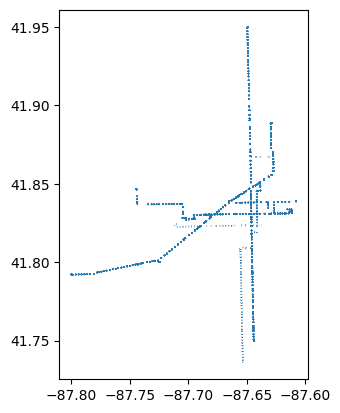

In [9]:
gdf_community_c["geometry"] = gpd.GeoSeries(gdf_community_c["geometry"]).simplify(tolerance=0.0001)
# gdf_community_c["geometry"] = gpd.GeoSeries(gdf_community_c["geometry"]).set_precision(0.0001)
gdf_community_c.plot()

In [7]:
gdf_community_c.explore(column = "minutes",
              # cmap = "RdYlGn_r",
            # cmap = "Greens_r",
            # cmap = "YlGn_r",
            cmap = "summer",
              opacity = 1,
              tiles="CartoDB positron")

---------
# Trying to merge geometries 

In [31]:
gdf_pattern = gpd.read_parquet("../../cta-stop-etl/out/patterns_current/pid_8128_stop.parquet")
gdf_segment = gpd.read_parquet("../../cta-stop-etl/out/patterns_current/pid_8128_segment.parquet")

# gdf_segment = gdf_segment.drop(columns = ["time_spent_in_segment", "ls_geometry"])

gdf_segment.head(3)

,segments,geometry,length_ft,ls_geometry
0,0,"POLYGON ((-87.66474 41.83917, -87.66475 41.839...",0.000000,POINT (-87.66535 41.83917)
1,1,"POLYGON ((-87.66477 41.83902, -87.66479 41.838...",20.155291,"LINESTRING (-87.66535 41.83917, -87.66536 41.8..."
2,2,"POLYGON ((-87.66534 41.83853, -87.66538 41.838...",135.047258,"LINESTRING (-87.66536 41.83912, -87.66574 41.8..."


In [32]:
gdf_segment.explore()

In [33]:
gdf_pattern.explore()

In [34]:
gdf_pattern["geometry"] = gdf_segment["geometry"]
gdf_pattern.explore()

In [35]:
gdf_segment["geometry"]

0     POLYGON ((-87.66474 41.83917, -87.66475 41.839...
1     POLYGON ((-87.66477 41.83902, -87.66479 41.838...
2     POLYGON ((-87.66534 41.83853, -87.66538 41.838...
3     POLYGON ((-87.66533 41.83853, -87.66537 41.838...
4     POLYGON ((-87.66526 41.83848, -87.66527 41.838...
                            ...                        
85    POLYGON ((-87.61434 41.83423, -87.6144 41.8342...
86    POLYGON ((-87.61398 41.83439, -87.61401 41.834...
87    POLYGON ((-87.6139 41.83368, -87.61391 41.8336...
88    POLYGON ((-87.61516 41.83321, -87.61522 41.833...
89    POLYGON ((-87.61533 41.83321, -87.61539 41.833...
Name: geometry, Length: 90, dtype: geometry